In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from sentence_transformers import SentenceTransformer
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.mixture import GaussianMixture

import pycaret.classification as pc

import boto3

C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sentence_transformers\cross_encoder\CrossEncoder.py:11: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm, trange


# public data: https://www.kaggle.com/datasets/maharshipandya/-spotify-tracks-dataset
# personal data: spotify API

In [2]:
def read_full_table(table_name):
    session = boto3.Session(profile_name="default")
    dynamodb = session.resource("dynamodb", region_name="eu-west-1")
    table = dynamodb.Table(table_name)
    response = table.scan()
    data = response["Items"]

    # Handle pagination
    while "LastEvaluatedKey" in response:
        response = table.scan(ExclusiveStartKey=response["LastEvaluatedKey"])
        data.extend(response["Items"])
        
    return pd.DataFrame(data)

In [3]:
numerical_cols = ["num_sections", "danceability", "sections_avg_duration", "instrumentalness", "liveness", "loudness",
                  "duration", "speechiness", "valence", "dynamics_changes", "tempo_changes", "acousticness",
                  "time_signature_changes", "popularity", "mode_changes", "energy", "key_changes", "tempo"]
numerical_cols_public = ["danceability", "instrumentalness", "liveness", "loudness", "duration", "speechiness", 
                         "valence", "acousticness", "popularity", "energy", "tempo"]

non_standarized_cols = ["num_sections", "sections_avg_duration", "loudness", "duration", "dynamics_changes", 
                         "tempo_changes", "time_signature_changes", "popularity", "mode_changes", "key_changes", "tempo"]
categorical_cols = ["key", "mode"]

notes = ("C", "C#", "D", "Eb", "E", "F", "F#", "G", "Ab", "A", "Bb", "B")
key_mapping = {i:note for i, note in enumerate(notes)}
key_mapping[-1] = "NoKey"

mode_mapping = {0: "Minor", 1: "Major"}

random_state = 602452

# Preprocess

In [4]:
top_artists_raw = read_full_table("top_artists")
recently_played_raw = read_full_table("recently_played")
track_info_raw = read_full_table("track_info")
public_data_raw = pd.read_csv(r"C:\Users\jcf\Desktop\codigo\Portfolio\Spotify Analysis\public_music_data.csv")

In [5]:
top_artists = top_artists_raw.copy()
recently_played = recently_played_raw.copy()
track_info = track_info_raw.copy()
public_data = public_data_raw.copy()

In [6]:
track_info["key"] = track_info["key"].map(key_mapping)
track_info["mode"] = track_info["mode"].map(mode_mapping)

public_data["key"] = public_data["key"].map(key_mapping)
public_data["mode"] = public_data["mode"].map(mode_mapping)

In [7]:
for col in numerical_cols:
    track_info[col] = pd.to_numeric(track_info[col])
    
for col in track_info.columns:
    if "changes" in col:
        track_info[col] = track_info[col] / track_info["duration"]

track_info["case"] = "user"

public_data["duration"] = public_data["duration_ms"] / 1000
public_data["case"] = "public"

genre_info = track_info.explode("genres")
genre_info = genre_info.loc[:, ["genres", "track_id", "artist"]]
genre_info = genre_info.groupby(["genres"]).nunique().reset_index()
genre_info["track_perc"] = 100 * genre_info["track_id"] / genre_info["track_id"].sum()
genre_info["artist_perc"] = 100 * genre_info["artist"] / genre_info["artist"].sum()

genre_info_public = public_data.loc[:, ["track_genre", "track_id", "artists"]]
genre_info_public = genre_info_public.groupby(["track_genre"]).nunique().reset_index()
genre_info_public["track_perc"] = 100 * genre_info_public["track_id"] / genre_info_public["track_id"].sum()
genre_info_public["artist_perc"] = 100 * genre_info_public["artists"] / genre_info_public["artists"].sum()

In [8]:
# genre_info = track_info.genres


In [8]:
# public_data

# do analysis (numerical and plots)
'track_name', 'album', 'artist', 'track_id', 'raw_sections'

'num_sections', 'danceability',  'sections_avg_duration',
'instrumentalness', 'liveness', 'loudness', 'duration', 'speechiness',
'valence', 'dynamics_changes', 'mode', 'tempo_changes',
'acousticness', 'time_signature_changes',
'popularity', 'mode_changes', 'energy', 'key_changes', 'key',
'tempo', 'explicit'

# show top artists and recenelty played in table

# plots: 
    X - histograma features canciones -> here/tableau
    X - histograma generos -> here
    X - correlaciones entre features -> here
    X - clustering usuario (y public?) -> here
    - predictor de genero con features (train con public, test con usuario. comparar con clusters de antes)
    X - comparativas usuario y public -> here
    
    -try to replicate them in tableau


# model:
# try to group more the genres (manually? semantic comparison?) -> to reduce the total 
# clustering kmeans usuario (standarize first)
# modelo predictor genero (?)

# Regression

## EDA

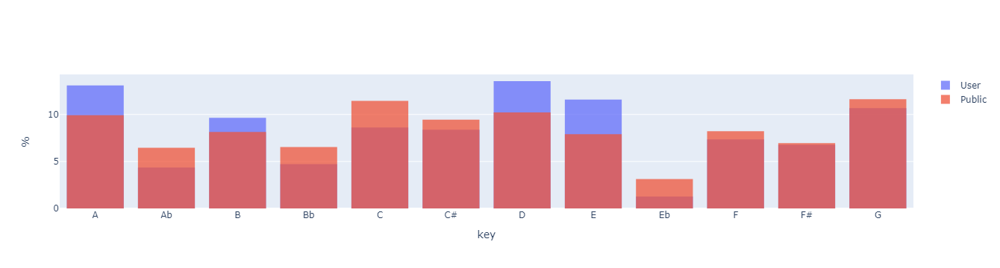

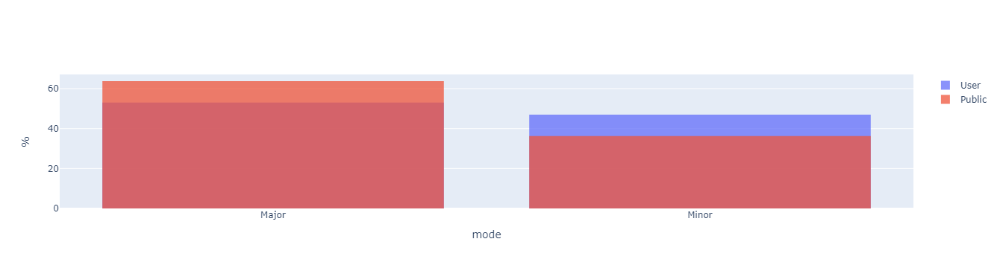

In [33]:
for col in categorical_cols:
    df = pd.concat([track_info, public_data]).loc[:, ["case", col]]
    df = df.sort_values(by=col)
    
    fig = go.Figure()
    fig.add_trace(go.Histogram(x=df.loc[df["case"] == "user", col], histnorm="percent", name="User"))
    fig.add_trace(go.Histogram(x=df.loc[df["case"] == "public", col], histnorm="percent", name="Public"))

    fig.update_layout(
        barmode="overlay",
        xaxis_title_text=col,
        yaxis_title_text='%'
    )
    fig.update_traces(opacity=0.75)
    fig.show()

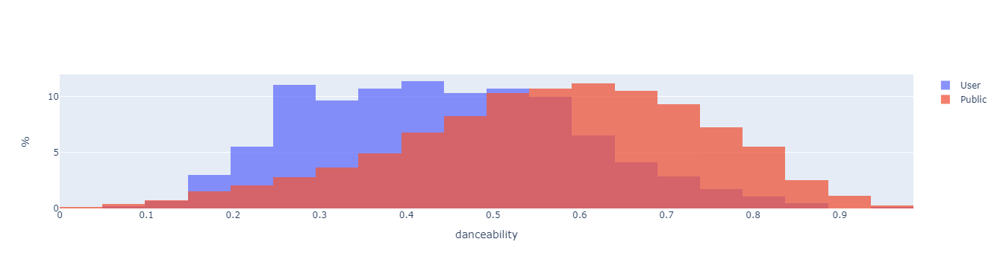

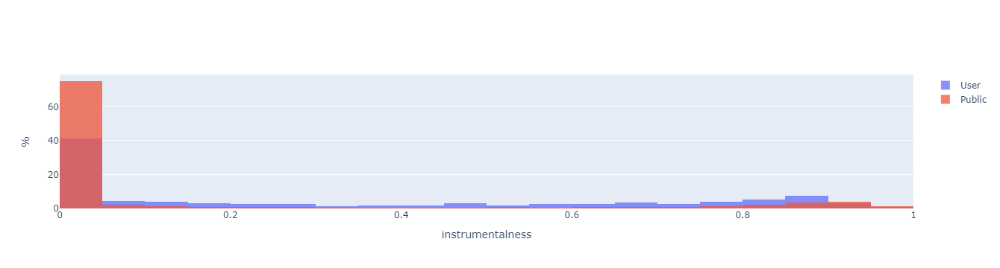

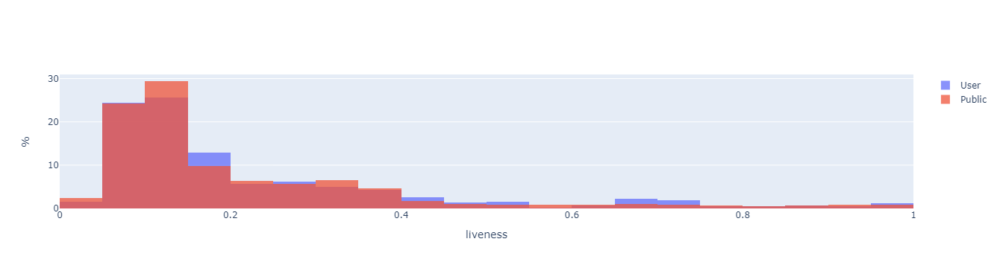

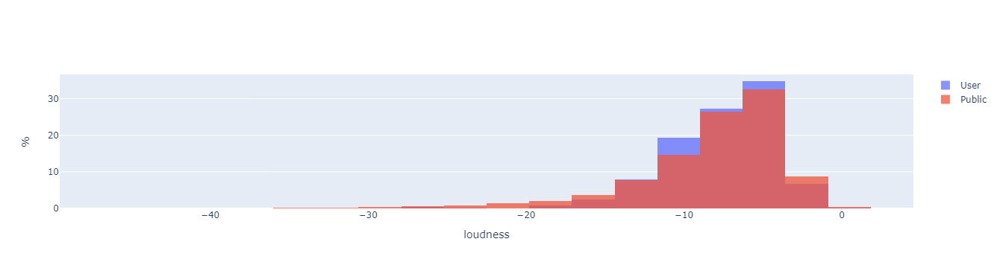

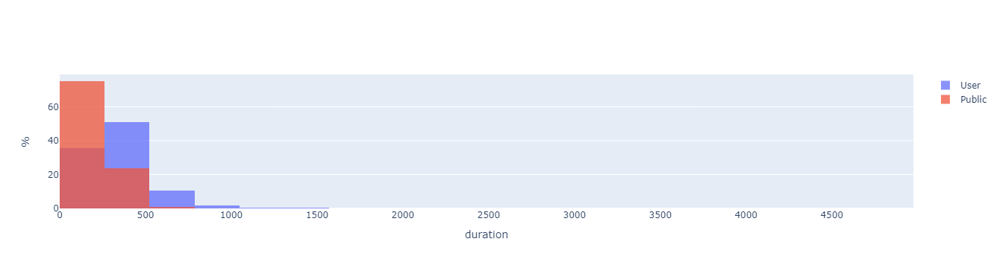

...

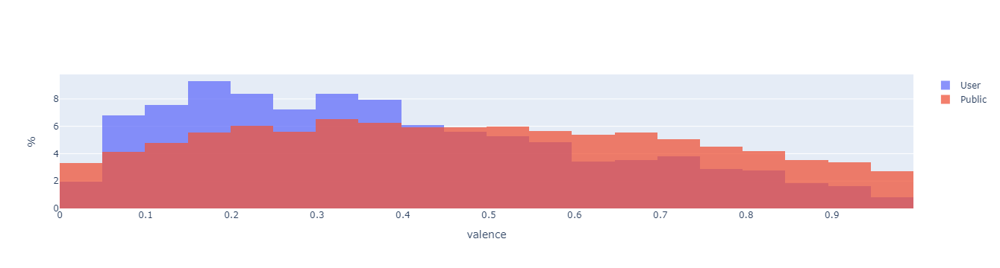

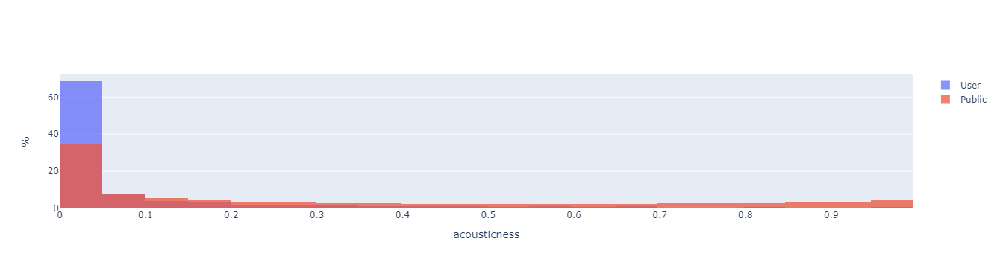

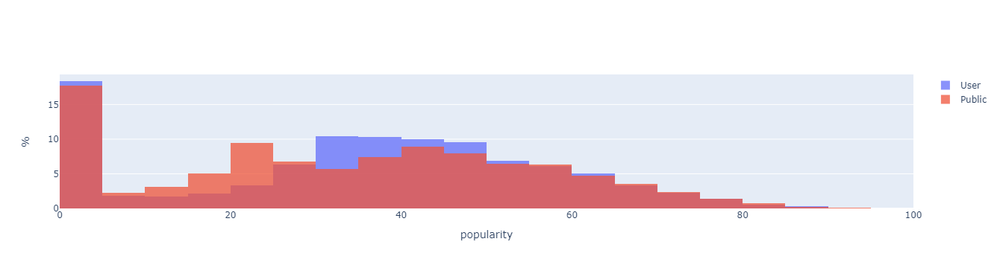

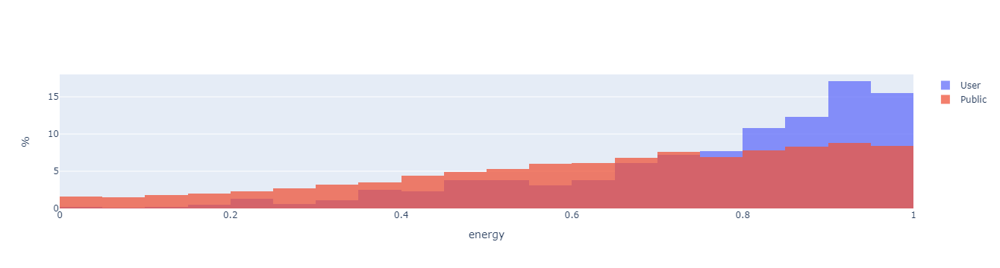

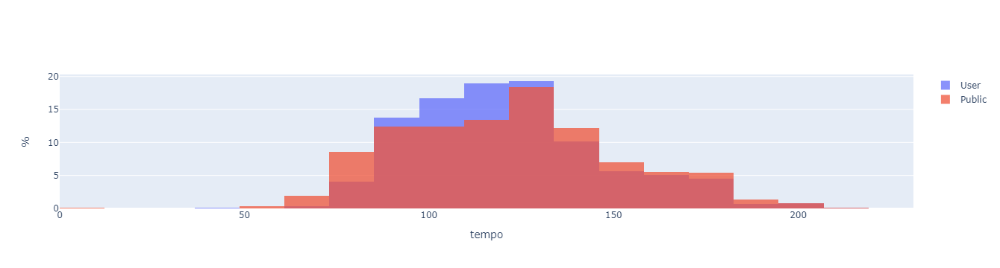

In [34]:
for col in numerical_cols:
    if col in track_info.columns and col in public_data.columns:
        df = pd.concat([track_info, public_data]).loc[:, ["case", col]]
        fig = go.Figure()

        bin_start = df[col].min()
        bin_end = df[col].max()
        bin_size = abs(bin_end - bin_start) / 20

        fig.add_trace(go.Histogram(x=df.loc[df["case"] == "user", col], histnorm="percent", name="User", autobinx=False, xbins=dict( 
                start=bin_start,
                end=bin_end,
                size=bin_size
            )))
        fig.add_trace(go.Histogram(x=df.loc[df["case"] == "public", col], histnorm="percent", name="Public", autobinx=False, xbins=dict(
                start=bin_start,
                end=bin_end,
                size=bin_size
            )))

        fig.update_layout(
            barmode="overlay",
            xaxis_title_text=col,
            yaxis_title_text='%'
        )
        fig.update_traces(opacity=0.75)
        fig.show()

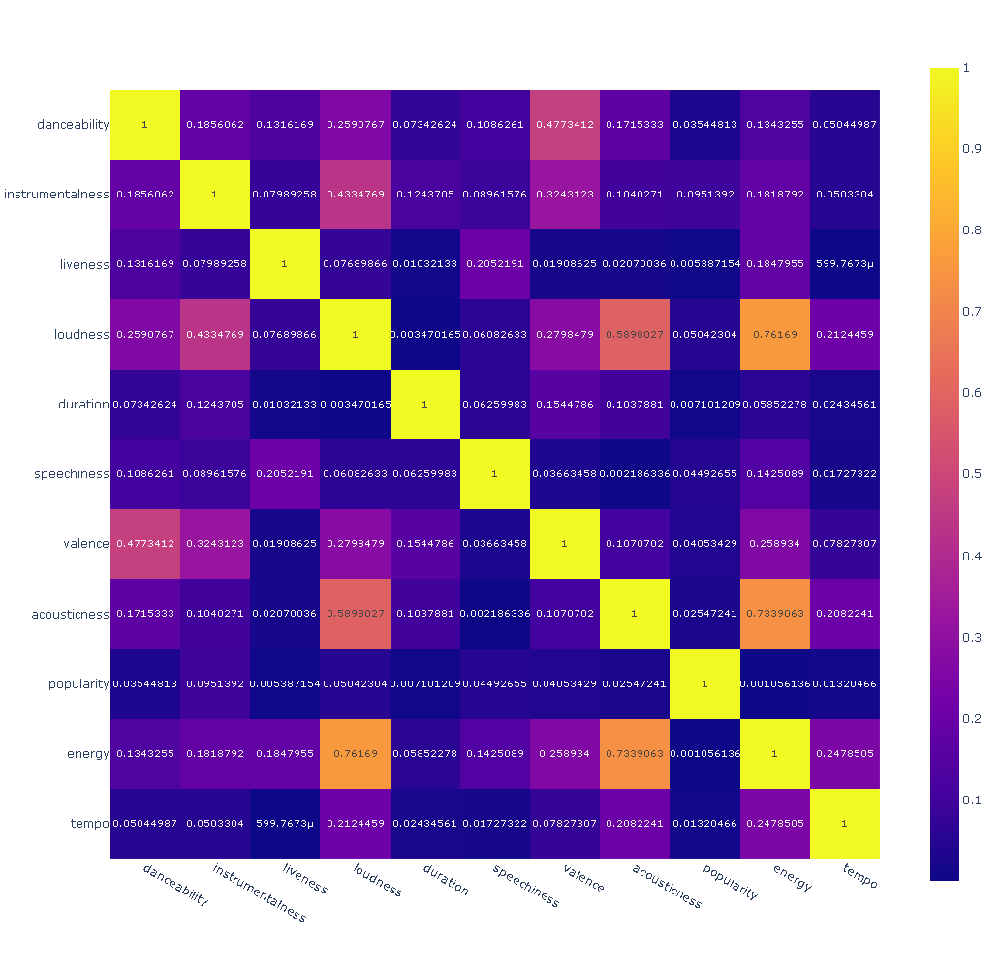

In [35]:
correlations_public = public_data[numerical_cols_public].corr().abs()

fig = px.imshow(correlations_public, text_auto=True)
fig.update_layout(width=1100, height=1000, autosize=False)

fig.show()

In [17]:
# Encoding categorical features
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from scipy.stats import f_oneway, chi2_contingency

df = public_data.copy()

one_hot_encoder = OneHotEncoder()
encoded_features = one_hot_encoder.fit_transform(df[categorical_cols])

encoded_df = pd.DataFrame(encoded_features.todense(), columns=one_hot_encoder.get_feature_names_out(categorical_cols))
df_encoded = pd.concat([df.drop(categorical_cols, axis=1), encoded_df], axis=1)

label_encoder = LabelEncoder()
df_encoded["track_genre"] = label_encoder.fit_transform(df_encoded['track_genre'])
numerical_features = numerical_cols_public
output = df_encoded['track_genre']

for feature in numerical_features:
    groups = [df_encoded[feature][df_encoded['track_genre'] == category] for category in df_encoded['track_genre'].unique()]
    f_val, p_val = f_oneway(*groups)
    print(f"ANOVA for {feature}: F-value = {f_val:.3f}, p-value = {p_val:.3f}")

categorical_features = encoded_df.columns

for feature in categorical_features:
    contingency_table = pd.crosstab(df_encoded[feature], output)
    chi2, p_value, _, _ = chi2_contingency(contingency_table)
    print(f"Chi-square test between {feature} and output: chi2 = {chi2:.3f}, p-value = {p_value:.3f}")

ANOVA for danceability: F-value = 714.110, p-value = 0.000
ANOVA for instrumentalness: F-value = 832.807, p-value = 0.000
ANOVA for liveness: F-value = 180.186, p-value = 0.000
ANOVA for loudness: F-value = 828.209, p-value = 0.000
ANOVA for duration: F-value = 198.542, p-value = 0.000
ANOVA for speechiness: F-value = 797.292, p-value = 0.000
ANOVA for valence: F-value = 441.163, p-value = 0.000
ANOVA for acousticness: F-value = 960.142, p-value = 0.000
ANOVA for popularity: F-value = 343.462, p-value = 0.000
ANOVA for energy: F-value = 842.844, p-value = 0.000
ANOVA for tempo: F-value = 93.752, p-value = 0.000
Chi-square test between key_A and output: chi2 = 750.010, p-value = 0.000
Chi-square test between key_Ab and output: chi2 = 782.307, p-value = 0.000
Chi-square test between key_B and output: chi2 = 732.271, p-value = 0.000
Chi-square test between key_Bb and output: chi2 = 670.181, p-value = 0.000
Chi-square test between key_C and output: chi2 = 919.286, p-value = 0.000
Chi-squar

In [8]:
track_info_regression = public_data.copy()
useless_cols = ["loudness", "energy", "acousticness", "valence", "danceability"] 
combinations_cols = [("valence", "danceability"), ("energy", "acousticness"), ("energy", "loudness")]
numerical_cols_extra = list(set(numerical_cols_public).difference(useless_cols))

for pair in combinations_cols:
    track_info_regression[f"{pair[0]} - {pair[1]}"] = track_info_regression[pair[0]] * track_info_regression[pair[1]]
    numerical_cols_extra.append(f"{pair[0]} - {pair[1]}")
    
# numerical_cols_extra = numerical_cols_extra + [f"{pair[0]} - {pair[1]}" for pair in combinations_cols]
regression_cols = numerical_cols_extra + categorical_cols

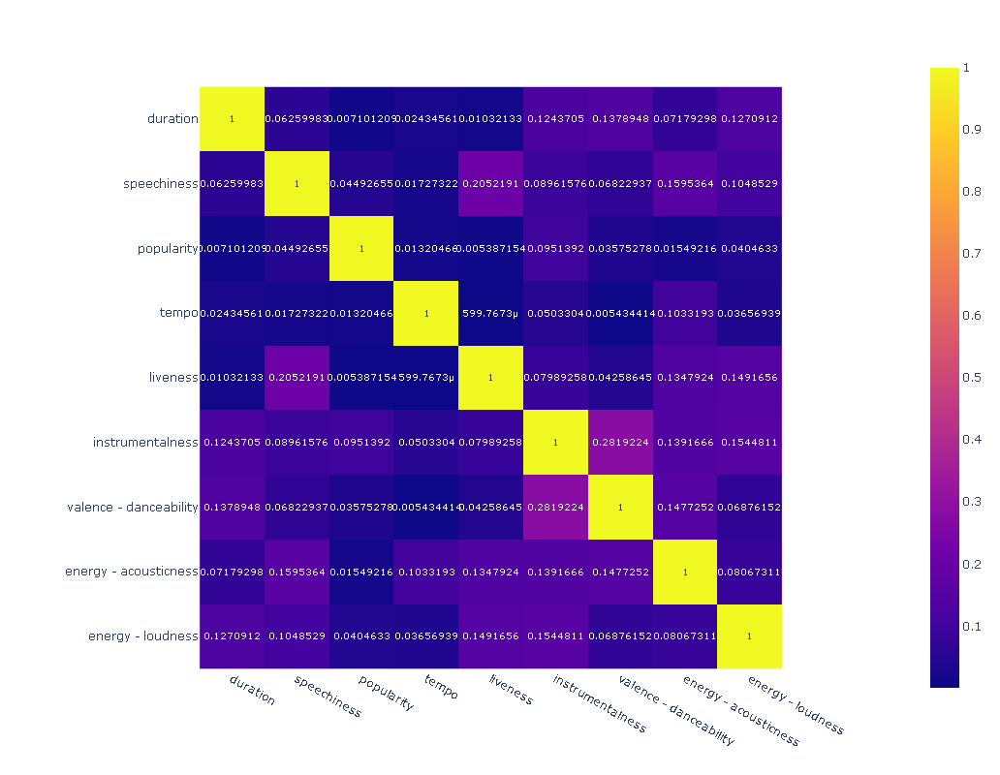

In [38]:
correlations_public = track_info_regression[numerical_cols_extra].corr().abs()

fig = px.imshow(correlations_public, text_auto=True)
fig.update_layout(width=1100, height=800, autosize=False)

fig.show()

In [19]:
X = track_info_regression[regression_cols]
X = pd.get_dummies(X, columns=categorical_cols)
Y = track_info_regression["track_genre"]

label_encoder = OneHotEncoder()
Y_encoded = label_encoder.fit_transform(pd.DataFrame(Y)).todense()

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

## Pycaret

In [17]:
data = track_info_regression.groupby("track_genre").sample(n=500, random_state=random_state)
data = data[regression_cols + ["track_genre"]]
# X_train, X_test, y_train, y_test = train_test_split(X_scaled, Y_encoded, test_size=0.1, random_state=random_state)
data['track_genre'] = data['track_genre'].astype('category')
data['key'] = data['key'].astype('category')
data['mode'] = data['mode'].astype('category')
data["popularity"] = data["popularity"].astype(np.int16)

for col in ("duration", "speechiness", "tempo", "liveness", "instrumentalness", "valence - danceability", "energy - acousticness", "energy - loudness"):
    data[col] = data[col].astype(np.float32)

try:
    best_model = pc.load_model('model_pycaret')    

except FileNotFoundError:
    clf1 = pc.setup(data, target='track_genre', verbose=False)
    best_model = pc.compare_models()
    pc.save_model(best_model, 'model_pycaret')

# # Print best model
print(best_model)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
rf,Random Forest Classifier,0.2919,0.8708,0.2919,0.2776,0.2783,0.2856,0.2857,25.8050
xgboost,Extreme Gradient Boosting,0.2876,0.9209,0.2876,0.2881,0.2853,0.2813,0.2813,13.9960
gbc,Gradient Boosting Classifier,0.2631,0.0000,0.2631,0.2566,0.2552,0.2566,0.2567,185.5970
dt,Decision Tree Classifier,0.1877,0.6032,0.1877,0.1919,0.1882,0.1805,0.1806,0.3570
lda,Linear Discriminant Analysis,0.1387,0.0000,0.1387,0.1123,0.1114,0.1310,0.1314,0.1160
nb,Naive Bayes,0.1298,0.8104,0.1298,0.1261,0.1063,0.1221,0.1230,0.2010
qda,Quadratic Discriminant Analysis,0.1252,0.0000,0.1252,0.1253,0.1097,0.1174,0.1180,0.1840
lr,Logistic Regression,0.1246,0.0000,0.1246,0.0982,0.0938,0.1169,0.1174,23.0360
knn,K Neighbors Classifier,0.1093,0.6292,0.1093,0.1279,0.1070,0.1014,0.1017,0.7480
ridge,Ridge Classifier,0.1039,0.0000,0.1039,0.0678,0.0585,0.0959,0.0976,0.0980


Transformation Pipeline and Model Successfully Saved
RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       monotonic_cst=None, n_estimators=100, n_jobs=-1,
                       oob_score=False, random_state=3603, verbose=0,
                       warm_start=False)


In [9]:
# pc.tune_model(best_model)
# data = track_info_regression.groupby("track_genre").sample(n=500, random_state=random_state)
data = track_info_regression[regression_cols + ["track_genre"]]
# X_train, X_test, y_train, y_test = train_test_split(X_scaled, Y_encoded, test_size=0.1, random_state=random_state)
data['track_genre'] = data['track_genre'].astype('category')
data['key'] = data['key'].astype('category')
data['mode'] = data['mode'].astype('category')
data["popularity"] = data["popularity"].astype(np.int16)

for col in ("duration", "speechiness", "tempo", "liveness", "instrumentalness", "valence - danceability", "energy - acousticness", "energy - loudness"):
    data[col] = data[col].astype(np.float32)

In [29]:
clf1 = pc.setup(data, target='track_genre', verbose=False)
# pc.save_experiment('regression')

In [34]:
best_models = pc.compare_models(n_select=3, cross_validation=False, include = ["gbc", 'rf', 'xgboost'])  

print(best_models)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
rf,Random Forest Classifier,0.2957,0.8764,0.2957,0.2822,0.2850,0.2894,0.2895,8.4700
xgboost,Extreme Gradient Boosting,0.2883,0.9362,0.2883,0.2874,0.2867,0.2820,0.2821,42.3800
gbc,Gradient Boosting Classifier,0.2808,0.9160,0.2808,0.2721,0.2718,0.2744,0.2745,2281.8600


[RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       monotonic_cst=None, n_estimators=100, n_jobs=-1,
                       oob_score=False, random_state=7738, verbose=0,
                       warm_start=False), XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device='cpu', early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold

In [ ]:
# pc.save_model(best_models, 'best_models')
# best_model = pc.load_model('best_models')  

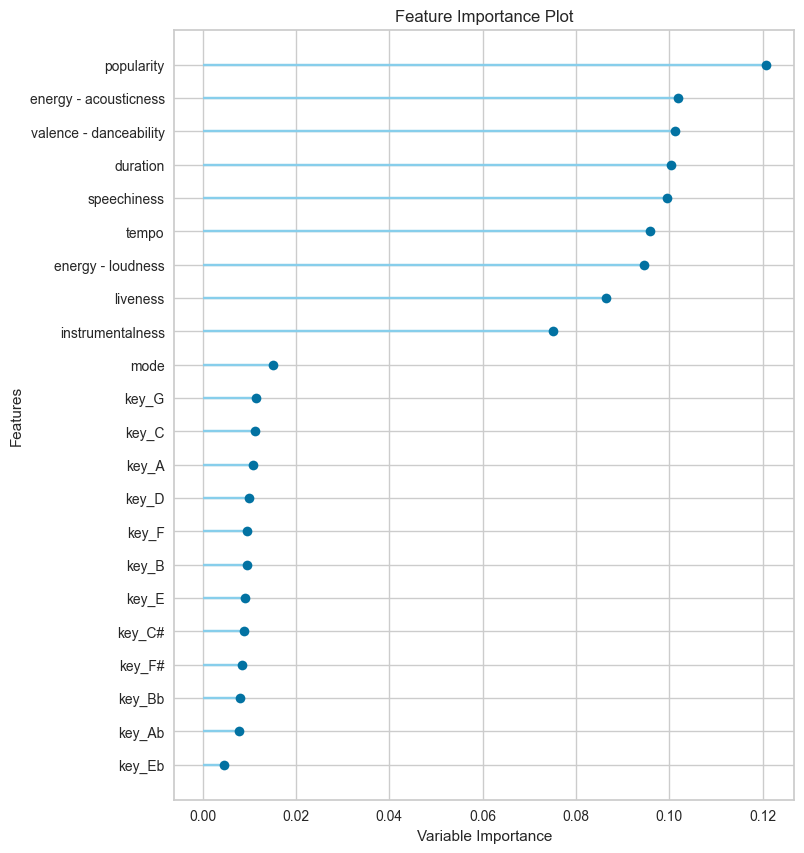

In [21]:
pc.plot_model(tuned_model, plot = 'feature_all')

In [25]:
preds = pc.predict_model(best_models[0])

preds["success"] = preds["track_genre"].eq(preds["prediction_label"]) 
success = preds.loc[:, ["track_genre", "success"]].groupby(["track_genre"]).agg(
    total=("track_genre", "count"),
    success=("success", "sum")).reset_index()
success["error"] = 100 * (1 - success["success"] / success["total"])

total_error = 100 * (1 * preds["success"].sum() / preds["success"].count())

print(f"{total_error=}%")

success.sort_values(by="error")

total_error=29.567251461988302%


,track_genre,total,success,error
42,grindcore,300,257,14.333333
101,sleep,300,255,15.000000
93,romance,300,248,17.333333
18,comedy,300,234,22.000000
95,salsa,300,231,23.000000
...,...,...,...,...
89,reggaeton,300,12,96.000000
88,reggae,300,11,96.333333
2,alt-rock,300,10,96.666667
32,electronic,300,8,97.333333


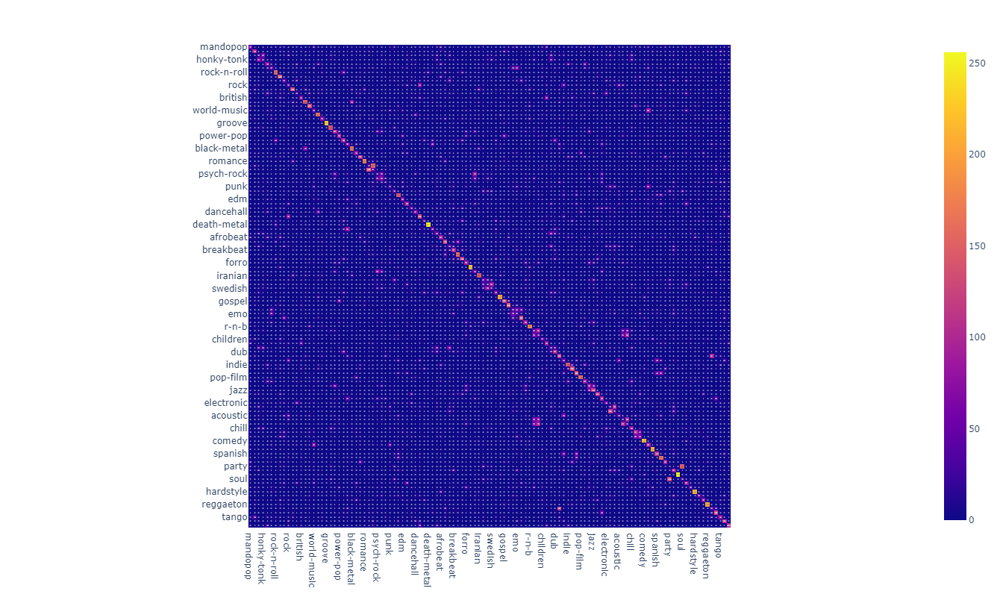

In [46]:
from sklearn.metrics import confusion_matrix
confusion = confusion_matrix(preds["track_genre"], preds["prediction_label"])

fig = px.imshow(confusion, text_auto=True, x=preds["track_genre"].unique(), y=preds["track_genre"].unique())
fig.update_layout(width=1300, height=800, autosize=False)

fig.show()

In [9]:
# from pycaret.classification import setup, compare_models, load_model, save_model, evaluate_model
best_model = pc.load_model('model_pycaret')    

In [10]:
clf1 = pc.load_experiment('regression', data=data)

In [35]:
pc.save_model(best_models, 'best_models')
# best_models = pc.load_model('best_models')    

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=None),
          steps=[('label_encoding',
                  TransformerWrapperWithInverse(exclude=None, include=None,
                                                transformer=LabelEncoder())),
                 ('numerical_imputer',
                  TransformerWrapper(exclude=None,
                                     include=['duration', 'liveness',
                                              'instrumentalness', 'tempo',
                                              'popularity', 'speechiness',
                                              'valence - danceability',
                                              'energy - acousticness',
                                              'energy - loudness'],...
                                              criterion='friedman_mse',
                                              init=None, learning_rate=0.1,
                                              loss='log_loss', max_depth=3,
                      

In [30]:
# xgboost_model = pc.create_model('xgboost')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.2890,0.9345,0.2890,0.2864,0.2858,0.2827,0.2827
1,0.2852,0.9347,0.2852,0.2839,0.2827,0.2789,0.2789
2,0.2919,0.9353,0.2919,0.2875,0.2875,0.2856,0.2856
3,0.2957,0.9365,0.2957,0.2964,0.2937,0.2895,0.2896
4,0.2925,0.9345,0.2925,0.2922,0.2904,0.2862,0.2863
5,0.2876,0.9334,0.2876,0.2870,0.2854,0.2813,0.2813
6,0.2927,0.9352,0.2927,0.2941,0.2912,0.2865,0.2865
7,0.2906,0.9355,0.2906,0.2910,0.2889,0.2843,0.2844
8,0.2919,0.9348,0.2919,0.2957,0.2915,0.2856,0.2856


In [141]:
# # pc.save_model(xgboost_model, 'xgboost_model')
# xgboost_model = pc.load_model('xgboost_model')    

Transformation Pipeline and Model Successfully Loaded


In [32]:
tuned_model

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       monotonic_cst=None, n_estimators=100, n_jobs=-1,
                       oob_score=False, random_state=7738, verbose=0,
                       warm_start=False)

In [17]:
tuned_model = pc.tune_model(best_models[0], fold=5)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.2663,0.9263,0.2663,0.2513,0.2256,0.2598,0.2605
1,0.2727,0.9278,0.2727,0.2682,0.2350,0.2663,0.2670
2,0.2690,0.9251,0.2690,0.2542,0.2293,0.2625,0.2632
3,0.2704,0.9268,0.2704,0.2598,0.2317,0.2639,0.2646
4,0.2730,0.9269,0.2730,0.2646,0.2345,0.2666,0.2673
Mean,0.2703,0.9266,0.2703,0.2596,0.2312,0.2638,0.2645
Std,0.0025,0.0009,0.0025,0.0063,0.0035,0.0025,0.0025


Fitting 5 folds for each of 10 candidates, totalling 50 fits
Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


In [32]:
# tuned_model = pc.tune_model(xgboost_model)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.3069,0.9390,0.3069,0.3019,0.3017,0.3008,0.3008
1,0.3036,0.9390,0.3036,0.3004,0.2998,0.2975,0.2975
2,0.3024,0.9396,0.3024,0.3001,0.2986,0.2962,0.2963
3,0.3035,0.9406,0.3035,0.3003,0.2993,0.2973,0.2974
4,0.2996,0.9386,0.2996,0.2994,0.2969,0.2934,0.2935
5,0.3041,0.9386,0.3041,0.3005,0.2998,0.2980,0.2980
6,0.3013,0.9401,0.3013,0.2984,0.2973,0.2951,0.2951
7,0.3014,0.9395,0.3014,0.2976,0.2971,0.2952,0.2952
8,0.3035,0.9403,0.3035,0.3018,0.3000,0.2973,0.2974


Fitting 10 folds for each of 10 candidates, totalling 100 fits


In [18]:
pc.save_model(tuned_model, 'tuned_model_def')
# tuned_model = pc.load_model('tuned_model')    

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=None),
          steps=[('label_encoding',
                  TransformerWrapperWithInverse(exclude=None, include=None,
                                                transformer=LabelEncoder())),
                 ('numerical_imputer',
                  TransformerWrapper(exclude=None,
                                     include=['duration', 'liveness',
                                              'instrumentalness', 'tempo',
                                              'popularity', 'speechiness',
                                              'valence - danceability',
                                              'energy - acousticness',
                                              'energy - loudness'],...
                  RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                                         class_weight=None, criterion='gini',
                                         max_depth=None, max_features='sqrt',
                  

In [28]:
# from pycaret.classification import plot_model

help(pc.plot_model)

Help on function plot_model in module pycaret.classification.functional:

plot_model(estimator, plot: str = 'auc', scale: float = 1, save: bool = False, fold: Union[int, Any, NoneType] = None, fit_kwargs: Optional[dict] = None, plot_kwargs: Optional[dict] = None, groups: Union[str, Any, NoneType] = None, verbose: bool = True, display_format: Optional[str] = None) -> Optional[str]
    This function analyzes the performance of a trained model on holdout set.
    It may require re-training the model in certain cases.
    
    Example
    -------
    >>> from pycaret.datasets import get_data
    >>> juice = get_data('juice')
    >>> from pycaret.classification import *
    >>> exp_name = setup(data = juice,  target = 'Purchase')
    >>> lr = create_model('lr')
    >>> plot_model(lr, plot = 'auc')
    
    
    estimator: scikit-learn compatible object
        Trained model object
    
    
    plot: str, default = 'auc'
        List of available plots (ID - Name):
    
        * 'pipeline'

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Random Forest Classifier,0.2956,0.8764,0.2956,0.2821,0.2850,0.2894,0.2895


In [ ]:
# accuracy = accuracy_score(y_test, y_pred)
# print(f'Accuracy: {accuracy:.2f}')


In [37]:
# # gbc_model = pc.create_model('gbc')
# rf_model = pc.create_model('rf')

# # gbc_model = pc.tune_model(gbc_model)
# rf_model = pc.tune_model(rf_model)

mixed_model = pc.blend_models(best_models)

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,20:48:39
Status,. . . . . . . . . . . . . . . . . .,Fitting 10 Folds
Estimator,. . . . . . . . . . . . . . . . . .,Voting Classifier


Processing:   0%|          | 0/6 [00:00<?, ?it/s]

ValueError: 
All the 10 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2 fits failed with the following error:
joblib.externals.loky.process_executor._RemoteTraceback: 
"""
Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\_parallel_backends.py", line 273, in _wrap_func_call
    return func()
           ^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in __call__
    return [func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in <listcomp>
    return [func(*args, **kwargs)
            ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 129, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_base.py", line 36, in _fit_single_estimator
    estimator.fit(X, y)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 489, in fit
    trees = Parallel(
            ^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 67, in __call__
    return super().__call__(iterable_with_config)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1863, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1792, in _get_sequential_output
    res = func(*args, **kwargs)
          ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 129, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 192, in _parallel_build_trees
    tree._fit(
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\tree\_classes.py", line 472, in _fit
    builder.build(self.tree_, X, y, sample_weight, missing_values_in_feature_mask)
  File "sklearn\\tree\\_tree.pyx", line 166, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 285, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 940, in sklearn.tree._tree.Tree._add_node
  File "sklearn\\tree\\_tree.pyx", line 909, in sklearn.tree._tree.Tree._resize_c
  File "sklearn\\tree\\_utils.pyx", line 35, in sklearn.tree._utils.safe_realloc
MemoryError: could not allocate 3735552 bytes
"""

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 278, in fit
    fitted_estimator = self._memory_fit(
                       ^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\memory.py", line 353, in __call__
    return self.func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 69, in _fit_one
    transformer.fit(*args)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_voting.py", line 366, in fit
    return super().fit(X, transformed_y, sample_weight)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_voting.py", line 89, in fit
    self.estimators_ = Parallel(n_jobs=self.n_jobs)(
                       ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 67, in __call__
    return super().__call__(iterable_with_config)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1952, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1595, in _get_outputs
    yield from self._retrieve()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1699, in _retrieve
    self._raise_error_fast()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1734, in _raise_error_fast
    error_job.get_result(self.timeout)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 736, in get_result
    return self._return_or_raise()
           ^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 754, in _return_or_raise
    raise self._result
MemoryError: could not allocate 3735552 bytes

--------------------------------------------------------------------------------
1 fits failed with the following error:
joblib.externals.loky.process_executor._RemoteTraceback: 
"""
Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\_parallel_backends.py", line 273, in _wrap_func_call
    return func()
           ^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in __call__
    return [func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in <listcomp>
    return [func(*args, **kwargs)
            ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 129, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_base.py", line 36, in _fit_single_estimator
    estimator.fit(X, y)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 489, in fit
    trees = Parallel(
            ^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 67, in __call__
    return super().__call__(iterable_with_config)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1863, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1792, in _get_sequential_output
    res = func(*args, **kwargs)
          ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 129, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 192, in _parallel_build_trees
    tree._fit(
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\tree\_classes.py", line 472, in _fit
    builder.build(self.tree_, X, y, sample_weight, missing_values_in_feature_mask)
  File "sklearn\\tree\\_tree.pyx", line 166, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 285, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 940, in sklearn.tree._tree.Tree._add_node
  File "sklearn\\tree\\_tree.pyx", line 909, in sklearn.tree._tree.Tree._resize_c
  File "sklearn\\tree\\_utils.pyx", line 35, in sklearn.tree._utils.safe_realloc
MemoryError: could not allocate 7471104 bytes
"""

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 278, in fit
    fitted_estimator = self._memory_fit(
                       ^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\memory.py", line 353, in __call__
    return self.func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 69, in _fit_one
    transformer.fit(*args)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_voting.py", line 366, in fit
    return super().fit(X, transformed_y, sample_weight)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_voting.py", line 89, in fit
    self.estimators_ = Parallel(n_jobs=self.n_jobs)(
                       ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 67, in __call__
    return super().__call__(iterable_with_config)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1952, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1595, in _get_outputs
    yield from self._retrieve()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1699, in _retrieve
    self._raise_error_fast()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1734, in _raise_error_fast
    error_job.get_result(self.timeout)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 736, in get_result
    return self._return_or_raise()
           ^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 754, in _return_or_raise
    raise self._result
MemoryError: could not allocate 7471104 bytes

--------------------------------------------------------------------------------
5 fits failed with the following error:
joblib.externals.loky.process_executor._RemoteTraceback: 
"""
Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\_parallel_backends.py", line 273, in _wrap_func_call
    return func()
           ^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in __call__
    return [func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in <listcomp>
    return [func(*args, **kwargs)
            ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 129, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_base.py", line 36, in _fit_single_estimator
    estimator.fit(X, y)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 489, in fit
    trees = Parallel(
            ^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 67, in __call__
    return super().__call__(iterable_with_config)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1863, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1792, in _get_sequential_output
    res = func(*args, **kwargs)
          ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 129, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 192, in _parallel_build_trees
    tree._fit(
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\tree\_classes.py", line 472, in _fit
    builder.build(self.tree_, X, y, sample_weight, missing_values_in_feature_mask)
  File "sklearn\\tree\\_tree.pyx", line 166, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 285, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 940, in sklearn.tree._tree.Tree._add_node
  File "sklearn\\tree\\_tree.pyx", line 909, in sklearn.tree._tree.Tree._resize_c
  File "sklearn\\tree\\_utils.pyx", line 35, in sklearn.tree._utils.safe_realloc
MemoryError: could not allocate 59768832 bytes
"""

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 278, in fit
    fitted_estimator = self._memory_fit(
                       ^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\memory.py", line 353, in __call__
    return self.func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 69, in _fit_one
    transformer.fit(*args)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_voting.py", line 366, in fit
    return super().fit(X, transformed_y, sample_weight)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_voting.py", line 89, in fit
    self.estimators_ = Parallel(n_jobs=self.n_jobs)(
                       ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 67, in __call__
    return super().__call__(iterable_with_config)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1952, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1595, in _get_outputs
    yield from self._retrieve()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1699, in _retrieve
    self._raise_error_fast()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1734, in _raise_error_fast
    error_job.get_result(self.timeout)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 736, in get_result
    return self._return_or_raise()
           ^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 754, in _return_or_raise
    raise self._result
MemoryError: could not allocate 59768832 bytes

--------------------------------------------------------------------------------
2 fits failed with the following error:
joblib.externals.loky.process_executor._RemoteTraceback: 
"""
Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\_parallel_backends.py", line 273, in _wrap_func_call
    return func()
           ^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in __call__
    return [func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in <listcomp>
    return [func(*args, **kwargs)
            ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 129, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_base.py", line 36, in _fit_single_estimator
    estimator.fit(X, y)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 489, in fit
    trees = Parallel(
            ^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 67, in __call__
    return super().__call__(iterable_with_config)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1863, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1792, in _get_sequential_output
    res = func(*args, **kwargs)
          ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 129, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 192, in _parallel_build_trees
    tree._fit(
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\tree\_classes.py", line 472, in _fit
    builder.build(self.tree_, X, y, sample_weight, missing_values_in_feature_mask)
  File "sklearn\\tree\\_tree.pyx", line 166, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 285, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 940, in sklearn.tree._tree.Tree._add_node
  File "sklearn\\tree\\_tree.pyx", line 909, in sklearn.tree._tree.Tree._resize_c
  File "sklearn\\tree\\_utils.pyx", line 35, in sklearn.tree._utils.safe_realloc
MemoryError: could not allocate 29884416 bytes
"""

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 278, in fit
    fitted_estimator = self._memory_fit(
                       ^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\memory.py", line 353, in __call__
    return self.func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 69, in _fit_one
    transformer.fit(*args)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_voting.py", line 366, in fit
    return super().fit(X, transformed_y, sample_weight)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_voting.py", line 89, in fit
    self.estimators_ = Parallel(n_jobs=self.n_jobs)(
                       ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 67, in __call__
    return super().__call__(iterable_with_config)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1952, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1595, in _get_outputs
    yield from self._retrieve()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1699, in _retrieve
    self._raise_error_fast()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1734, in _raise_error_fast
    error_job.get_result(self.timeout)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 736, in get_result
    return self._return_or_raise()
           ^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 754, in _return_or_raise
    raise self._result
MemoryError: could not allocate 29884416 bytes


In [ ]:
pc.save_model(mixed_model, 'mixed_model')
# mixed_model = pc.load_model('mixed_model')   

In [ ]:
# final_best = finalize_model(best)
# to train model on full dataset

In [45]:
# Pycaret eats all memory. Trying direct scikit pipeline

,liveness,duration,tempo,instrumentalness,speechiness,popularity,valence - danceability,energy - acousticness,energy - loudness,key,mode
57628,0.1210,162.352005,170.136002,0.000000,0.0432,46,0.262344,0.249936,-4.229100,F,Major
87885,0.8330,150.666000,90.009003,0.000001,0.0284,40,0.368480,0.080955,-5.112501,F#,Major
36061,0.5270,161.651993,121.004997,0.002950,0.1370,61,0.286560,0.111520,-5.244064,C,Minor
52824,0.0902,221.533005,91.718002,0.000514,0.0289,10,0.139440,0.115200,-4.934144,A,Major
113951,0.3520,338.694000,144.056000,0.000000,0.0354,44,0.065852,0.018522,-3.696368,Bb,Major
...,...,...,...,...,...,...,...,...,...,...,...
58957,0.4480,239.399994,87.425003,0.009000,0.0983,22,0.084864,0.000149,-3.368399,A,Minor
71176,0.0933,315.119995,116.898003,0.002230,0.0808,0,0.300884,0.000110,-5.644672,F#,Minor
63714,0.3110,204.559998,103.171997,0.000002,0.0825,38,0.538227,0.009220,-11.587540,B,Major
77089,0.9530,161.264999,141.863007,0.000000,0.0515,53,0.391872,0.247390,-4.938505,B,Minor


In [51]:
data.describe()

,liveness,duration,tempo,instrumentalness,speechiness,popularity,valence - danceability,energy - acousticness,energy - loudness
count,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000
mean,0.213553,228.029175,122.147842,0.156050,0.084652,33.238535,0.290179,0.140595,-4.333607
std,0.190378,107.297714,29.978197,0.309555,0.105732,22.305078,0.198136,0.149414,1.884867
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-33.694191
25%,0.098000,174.065994,99.218752,0.000000,0.035900,17.000000,0.123018,0.011997,-5.195879
50%,0.132000,212.906006,122.016998,0.000042,0.048900,35.000000,0.258585,0.091655,-4.107550
75%,0.273000,261.506012,140.070999,0.049000,0.084500,50.000000,0.432752,0.231545,-3.221971
max,1.000000,5237.294922,243.371994,1.000000,0.965000,100.000000,0.958432,0.994000,4.527468


In [48]:
type(tuned_model)

pycaret.internal.pipeline.Pipeline

In [40]:
for e in tuned_model.steps:
    print(e)

('label_encoding', TransformerWrapperWithInverse(exclude=None, include=None,
                              transformer=LabelEncoder()))
('numerical_imputer', TransformerWrapper(exclude=None,
                   include=['duration', 'liveness', 'instrumentalness', 'tempo',
                            'popularity', 'speechiness',
                            'valence - danceability', 'energy - acousticness',
                            'energy - loudness'],
                   transformer=SimpleImputer(add_indicator=False, copy=True,
                                             fill_value=None,
                                             keep_empty_features=False,
                                             missing_values=nan,
                                             strategy='mean')))
('categorical_imputer', TransformerWrapper(exclude=None, include=['key', 'mode'],
                   transformer=SimpleImputer(add_indicator=False, copy=True,
                                           

In [142]:
xgboost_model

Pipeline(memory=FastMemory(location=C:\Users\jcf\AppData\Local\Temp\joblib),
         steps=[('label_encoding',
                 TransformerWrapperWithInverse(exclude=None, include=None,
                                               transformer=LabelEncoder())),
                ('numerical_imputer',
                 TransformerWrapper(exclude=None,
                                    include=['duration', 'liveness',
                                             'instrumentalness', 'tempo',
                                             'popularity', 'speechiness',
                                             'valence - danceability',
                                             'en...
                               importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=None, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, multi_strategy=None,
                               n_estimators=None, n_jobs=-1,
                               num_parallel_tree=None,
                               objective='multi:softprob', ...))],
         verbose=False)

In [43]:
type(tuned_model.steps[-1][-1])

xgboost.sklearn.XGBClassifier

In [54]:
# ordinal_encoding', TransformerWrapper(exclude=None, include=['mode'],
#                    transformer=OrdinalEncoder(cols=['mode'],
#                                               drop_invariant=False,
#                                               handle_missing='return_nan',
#                                               handle_unknown='value',
#                                               mapping=[{'col': 'mode',
#                                                         'data_type': dtype('O'),
#                                                         'mapping': Major    0
# Minor    1
# NaN     -1
# dtype: int64}],
#                                               return_df=True, verbose=0)))
# ('onehot_encoding', TransformerWrapper(exclude=None, include=['key'],
#                    transformer=OneHotEncoder(cols=['key'], drop_invariant=False,
#                                              handle_missing='return_nan',
#                                              handle_unknown='value',
#                                              return_df=True, use_cat_names=True,
#                                              verbose=0)))


# from sklearn.compose import ColumnTransformer
# from sklearn.pipeline import Pipeline
# from sklearn.preprocessing import OneHotEncoder
# from sklearn.preprocessing import MinMaxScaler
# from sklearn.ensemble import RandomForestClassifier

# #transform columns
# #num_cols = numerical columns, categorical_col = categorical columns
# preprocessor = ColumnTransformer(transformers = [('minmax',MinMaxScaler(), num_cols),
#                                                  ('onehot', OneHotEncoder(), categorical_col)])

# #model
# model = RandomForestClassifier(random_state=0)

# #model pipeline
# model_pipeline = Pipeline(steps=[('preprocessor', preprocessor), ('model', model)])

# model_pipeline.fit(x_train, y_train)
regression_cols + ["track_genre"]

['liveness',
 'duration',
 'tempo',
 'instrumentalness',
 'speechiness',
 'popularity',
 'valence - danceability',
 'energy - acousticness',
 'energy - loudness',
 'key',
 'mode',
 'track_genre']

In [55]:
 numerical_cols_extra + categorical_cols

['liveness',
 'duration',
 'tempo',
 'instrumentalness',
 'speechiness',
 'popularity',
 'valence - danceability',
 'energy - acousticness',
 'energy - loudness',
 'key',
 'mode']

In [150]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OrdinalEncoder, OneHotEncoder, LabelEncoder, FunctionTransformer
from sklearn.compose import ColumnTransformer
from xgboost import XGBClassifier


# 1. ordinal encoding in mode
# 2. one hot in key
# 3. 

ordinal_encoder = OrdinalEncoder(handle_unknown='error')
one_hot_encoder = OneHotEncoder(handle_unknown='error')
preprocessor = ColumnTransformer(transformers = [('ordinal', ordinal_encoder, ["mode"]),
                                                 ('onehot', one_hot_encoder, ["key"])])
label_encoder = LabelEncoder()

# Define a custom transformer using FunctionTransformer
def encode_target(y):
    return label_encoder.fit_transform(y)

def decode_target(y):
    return label_encoder.inverse_transform(y)

target_encoder = FunctionTransformer(encode_target, validate=False)
xgtboost_model = XGBClassifier()
# xgtboost_model = XGBClassifier(n_estimators=280,
#  objective="multi:softprob",
#  max_depth=6,
#  max_leaves=None,
#  max_bin=None,
#  grow_policy=None,
#  learning_rate=0.1,
#  verbosity=0,
# booster="gbtree",
#  tree_method="auto",
#  gamma=None,
#  min_child_weight=2,
#  max_delta_step=None,
#  subsample=1,
#  sampling_method=None,
#  colsample_bytree=1,
#  colsample_bylevel=None,
#  colsample_bynode=None,
#  reg_alpha=0.1,
#  reg_lambda=1e-07,
#  scale_pos_weight=47.2,
#  base_score=None,
#  missing=np.nan,
#  num_parallel_tree=None,
#  random_state=7738,
#  n_jobs=-1,
#  monotone_constraints=None,
#  interaction_constraints=None,
#  importance_type=None,
#  device="cpu",
#  validate_parameters=None,
#  enable_categorical=False,
#  feature_types=None,
#  max_cat_to_onehot=None,
#  max_cat_threshold=None,
#  multi_strategy=None,
#  eval_metric=None,
#  early_stopping_rounds=None,
#  callbacks=None,
#  n_classes_=114)

custom_pipe = Pipeline(steps=[('preprocessor', preprocessor), ('model', xgtboost_model)])

custom_pipe

Pipeline(memory=None,
         steps=[('preprocessor',
                 ColumnTransformer(n_jobs=None, remainder='drop',
                                   sparse_threshold=0.3,
                                   transformer_weights=None,
                                   transformers=[('ordinal',
                                                  OrdinalEncoder(categories='auto',
                                                                 dtype=<class 'numpy.float64'>,
                                                                 encoded_missing_value=nan,
                                                                 handle_unknown='error',
                                                                 max_categories=None,
                                                                 min_frequency=None,
                                                                 unknown_value=None),
                                                  ['mode']),
                                                 ('onehot...
                               importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=None, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, multi_strategy=None,
                               n_estimators=None, n_jobs=None,
                               num_parallel_tree=None,
                               objective='binary:logistic', ...))],
         verbose=False)

In [111]:
X_train = pc.get_config(variable="X_train")
X_test = pc.get_config(variable="X_test")
y_train = pc.get_config(variable="y_train")
y_test = pc.get_config(variable="y_test")

In [144]:
y_train_enc = target_encoder.fit_transform(y_train)
y_test_enc = target_encoder.transform(y_test)

custom_pipe.fit(X_train, y_train_enc)

Pipeline(memory=None,
         steps=[('preprocessor',
                 ColumnTransformer(n_jobs=None, remainder='drop',
                                   sparse_threshold=0.3,
                                   transformer_weights=None,
                                   transformers=[('ordinal',
                                                  OrdinalEncoder(categories='auto',
                                                                 dtype=<class 'numpy.float64'>,
                                                                 encoded_missing_value=nan,
                                                                 handle_unknown='error',
                                                                 max_categories=None,
                                                                 min_frequency=None,
                                                                 unknown_value=None),
                                                  ['mode']),
                                                 ('onehot...
                               feature_types=None, gamma=None, grow_policy=None,
                               importance_type=None,
                               interaction_constraints=None, learning_rate=0.1,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=6, max_leaves=None, min_child_weight=2,
                               missing=nan, monotone_constraints=None,
                               multi_strategy=None, n_classes_=114,
                               n_estimators=280, n_jobs=-1,
                               num_parallel_tree=None, ...))],
         verbose=False)

In [ ]:
from hyperopt import fmin, tpe, hp

# Define the hyperparameter space
space = {
    'max_depth': hp.quniform('max_depth', 2, 8, 1),
    'learning_rate': hp.loguniform('learning_rate', -5, -2),
    'subsample': hp.uniform('subsample', 0.5, 1),
    ""
}
reg_alpha=0.1,
#  reg_lambda=1e-07,
#  scale_pos_weight=47.2,

# Define the objective function to minimize
def objective(params):
    xgb_model = XGBClassifier(objective="multi:softprob", **params)
    custom_pipe = Pipeline(steps=[('preprocessor', preprocessor), ('model', xgb_model)])
    
    custom_pipe.fit(X_train, y_train)
    y_pred = custom_pipe.predict(X_test)
    score = accuracy_score(y_test, y_pred)
    return {'loss': -score, 'status': STATUS_OK}

# Perform the optimization
best_params = fmin(objective, space, algo=tpe.suggest, max_evals=100)
print("Best set of hyperparameters: ", best_params)

In [112]:
y_train_enc

array([56, 87, 36, ..., 63, 77, 97])

In [145]:
from sklearn.metrics import accuracy_score

y_pred_enc = custom_pipe.predict(X_test)

# Decode the predictions
y_pred = decode_target(y_pred_enc)

# Evaluate the model
y_pred

array(['samba', 'romance', 'bluegrass', ..., 'piano', 'detroit-techno',
       'drum-and-bass'], dtype=object)

In [146]:
y_pred_enc

array([96, 93,  7, ..., 79, 24, 27], dtype=int64)

In [147]:
y_test_enc

array([ 70,  80,  88, ...,  39,  39, 106])

In [148]:
preds_2 = pd.concat([X_test, y_test], axis=1)
preds_2["prediction_label"] = y_pred

preds_2["success"] = preds_2["track_genre"].eq(preds_2["prediction_label"]) 
success = preds_2.loc[:, ["track_genre", "success"]].groupby(["track_genre"]).agg(
    total=("track_genre", "count"),
    success=("success", "sum")).reset_index()
success["error"] = 100 * (1 - success["success"] / success["total"])

total_error = 1- (100 * preds_2["success"].sum() / preds_2["success"].count())

print(f"{total_error=}%")

success.sort_values(by="error")

total_error=-0.9795321637426901%


,track_genre,total,success,error
7,bluegrass,300,85,71.666667
93,romance,300,57,81.000000
96,samba,300,51,83.000000
26,disney,300,48,84.000000
42,grindcore,300,47,84.333333
...,...,...,...,...
35,forro,300,0,100.000000
34,folk,300,0,100.000000
33,emo,300,0,100.000000
44,grunge,300,0,100.000000


In [149]:
# pycaret sucks try to fit models using only sklearn

In [ ]:
# train model with public data, test with user

In [ ]:
# repeat with clustered genres -> need to cluster public genres

In [ ]:
# save

In [ ]:
import chart_studio


chart_studio.tools.set_credentials_file(username='jcf94', api_key='Ma8Fg56h3ANUjoPRemcK')

In [ ]:
import chart_studio.plotly as py

fig = px.imshow(correlations, text_auto=True)
fig.update_layout(width=1300, height=1200, autosize=False)
py.plot(fig, filename = 'test-plot', auto_open=True)

In [ ]:
# save results to csv
# save html with numerical and plotly plots 

top_artists.to_csv("top_artists.csv")
recently_played.to_csv("recently_played.csv")